In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
import numpy as np
import matplotlib.colors as mc
import colorsys
from IPython.display import HTML
from datetime import datetime
from random import randint
import seaborn as sns
import matplotlib.animation as animation
from IPython.display import HTML
import requests
import io
import csv

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
    url = 'https://api.covidtracking.com/v1/states/daily.csv'
    s = requests.get(url).content
    cols_to_use = ['date', 'state', 'hospitalizedCurrently', 'deathIncrease', 'positiveIncrease']
    df = pd.read_csv(io.StringIO(s.decode('utf-8')), usecols=cols_to_use)

In [4]:
with open('/content/drive/My Drive/Projects/covid_state_racing_animation/state_to_pop.csv', mode='r') as infile:
    reader = csv.reader(infile)
    next(reader, None)
    state_to_pop_dict = {rows[0]:rows[1] for rows in reader}
with open('/content/drive/My Drive/Projects/covid_state_racing_animation/code_to_state.csv', mode='r') as infile:
    reader = csv.reader(infile)
    next(reader, None)
    code_to_state_dict = {rows[0]:rows[1] for rows in reader}

In [5]:
df = df[~df.state.isin(['GU', 'AS', 'MP', 'PR', 'VI'])]

In [6]:
df['hospitalizedCurrently'] = df['hospitalizedCurrently'].fillna(0)

In [7]:
dff = pd.DataFrame(df.groupby(['state','date'])['hospitalizedCurrently'].sum()).reset_index()

In [8]:
# normalize by hospitalizations per million
lst = [state_to_pop_dict[state] for state in dff.state]
s = pd.Series(lst)
s = s.replace(',','', regex = True)
s = s.astype(int)
s.name = 'population'

In [9]:
dff = pd.concat([dff, s], axis=1)

In [10]:
dff.hospitalizedCurrently = dff.hospitalizedCurrently / dff.population * 1000000

In [11]:
# replace code with full state name
lst = [code_to_state_dict[code] for code in dff.state]
s = pd.Series(lst)
dff.state = s

In [12]:
dff.head()

,state,date,hospitalizedCurrently,population
0,Alaska,20200306,0.0,731545
1,Alaska,20200307,0.0,731545
2,Alaska,20200308,0.0,731545
3,Alaska,20200309,0.0,731545
4,Alaska,20200310,0.0,731545


In [13]:
current_date = 20201105
dfff = dff[dff['date'].eq(current_date)].sort_values(by='hospitalizedCurrently', ascending=False).head(15)

<BarContainer object of 15 artists>

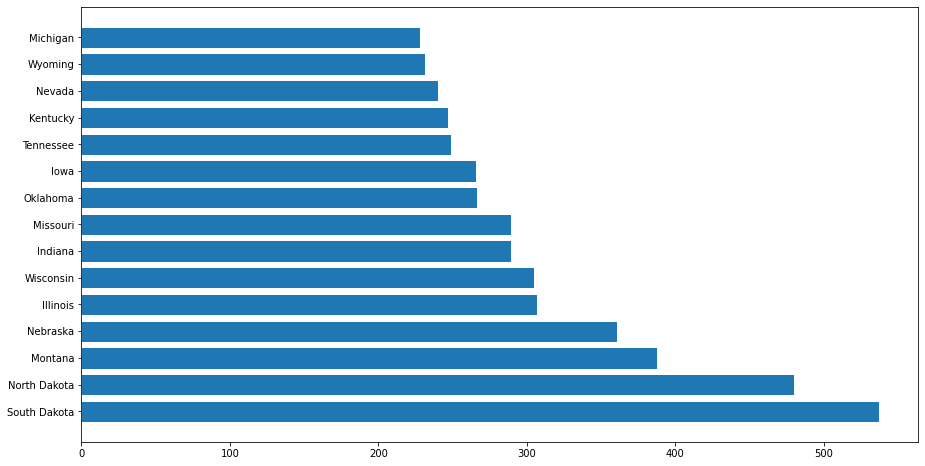

In [14]:
fig, ax = plt.subplots(figsize=(15, 8))
sns.set(style="darkgrid")
ax.barh(dfff['state'], dfff['hospitalizedCurrently'])

In [15]:
dff = dff[dff.date > 20200320]

In [16]:
def transform_color(color, amount = 0.5):
    try:
        c = mc.cnames[color]
    except:
        c = color
        c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])
    
all_names = dff['state'].unique().tolist()
random_hex_colors = []
for i in range(len(all_names)):
    random_hex_colors.append('#' + '%06X' % randint(0, 0xFFFFFF))
    
rgb_colors = [transform_color(i, 1) for i in random_hex_colors]
rgb_colors_opacity = [rgb_colors[x] + (0.325,) for x in range(len(rgb_colors))]

In [17]:
def draw_barchart(date):
    dfff = dff[dff['date'].eq(date)].sort_values(by='hospitalizedCurrently').tail(20)
    ax.clear()

    normal_colors = dict(zip(dff['state'].unique(), rgb_colors_opacity))

    ax.barh(dfff['state'], dfff['hospitalizedCurrently'], color = [normal_colors[x] for x in dfff['state']])
    dx = dfff['hospitalizedCurrently'].max() / 100
    for i, (value, name) in enumerate(zip(dfff['hospitalizedCurrently'], dfff['state'])):
        ax.text(value-dx, i, name, size=12, weight=800, ha='right')
        ax.text(value+dx, i, f'{value:,.0f}',  size=10, ha='left',  va='center')

    # Style the bar
    ax.text(1, 0.4, datetime.strptime(str(date), '%Y%m%d').strftime("%B"), transform=ax.transAxes, color='#766712', size=56, ha='right', weight=500)
    ax.text(1, 0.3, str(date)[:4] + '-' + str(date)[4:6] + '-' + str(date)[6:], transform=ax.transAxes, color='#777777', size=20, ha='right', weight=500)
    ax.text(0, 1.06, 'Currently Hospitalized', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, '\nCOVID-19 Current Hospitalizations per million', transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)
    plt.tight_layout()
    

In [18]:
dates=pd.Series(dff['date'].unique())
dates.dropna(inplace=True)
dates = dates.astype(int)

Animation size has reached 21038694 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


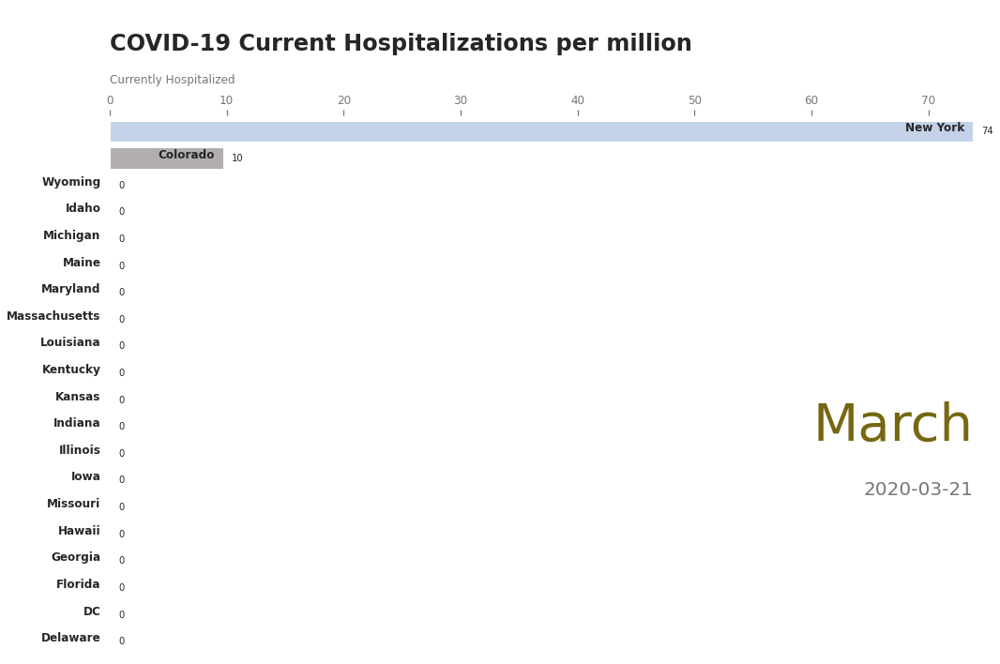

In [19]:
fig, ax = plt.subplots(figsize=(15, 10 ))
animator = animation.FuncAnimation(fig, draw_barchart, frames=dates, interval=150)
HTML(animator.to_jshtml())

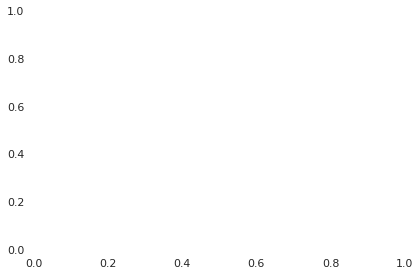

In [20]:
animator.save('covid_states.gif', writer='pillow')